In [3]:
%cd ..

/home/prayson/Code/apartements


In [6]:
import pandas as pd
import numpy as np
from scipy import stats
import plotly.express as px

from sklearn.linear_model import LinearRegression

In [7]:
df = pd.read_csv("assets/data/bolig.csv.gzip",
                 compression="gzip", 
                 parse_dates=["soldDate"])
df.sample(4)

,estateId,address,zipCode,price,soldDate,propertyType,saleType,sqmPrice,rooms,size,...,change,guid,latitude,longitude,municipalityCode,estateCode,city,groupKey,canGetVR,bfEnr
87952,0,"Genforeningspladsen 16, 2. th",2400,1275314,2003-11-16 23:00:00+00:00,3,Alm. Salg,20243.080,2.0,63,...,0.000000,E895049D-11F1-45E9-8D1E-1CCBAD052DCC,55.699280,12.521485,101,177262,København NV,NaN,True,161404
24844,0,"Skjalm Hvides Gade 13, 4. tv",1728,26650026,2022-02-27 23:00:00+00:00,3,Fam. Salg,251415.340,2.0,106,...,0.000000,DE47C023-42A5-4A62-86FA-91FE4CF51559,55.664640,12.550986,101,263304,København V,2.0,True,6025008
46574,1539222,"Brønshøjvej 10, 4",2700,4775000,2019-04-13 22:00:00+00:00,3,Alm. Salg,31414.475,5.0,152,...,-4.404404,1494A4E3-4F40-4DA8-9DC1-740582C78125,55.703500,12.497551,101,980286,Brønshøj,NaN,True,106923
84428,0,"Mosesvinget 26, st",2400,3295000,2006-02-12 23:00:00+00:00,3,Alm. Salg,47071.430,2.0,70,...,0.000000,C5467DDD-CCD1-4D4B-939F-728A248048AB,55.714237,12.507003,101,382486,København NV,4.0,True,6002756


In [8]:
LOWER_PRICE, HIGHER_PRICE = 500_000, 9_000_000
NUMBER_OF_ROOMS = 6
SALES_TYPE = 'Alm. Salg'

(df
     .loc[(df['saleType'].eq(SALES_TYPE)) &
           (df['price'].between(LOWER_PRICE, HIGHER_PRICE)) &
           (df['rooms'].lt(NUMBER_OF_ROOMS))
 ]
     .sort_values(by="soldDate")

).sample(5)

,estateId,address,zipCode,price,soldDate,propertyType,saleType,sqmPrice,rooms,size,...,change,guid,latitude,longitude,municipalityCode,estateCode,city,groupKey,canGetVR,bfEnr
35456,1695217,"Holmbladsgade 81, 1. th",2300,2180000,2020-11-23 23:00:00+00:00,3,Alm. Salg,41923.08,2.0,52,...,-5.010893,5A1A420E-CB3E-4CF9-9893-40E26CF8C5E3,55.666477,12.612747,101,234169,København S,NaN,True,132705
24515,1866568,"Brønshøj Kirkevej 2, 1. th",2700,1715000,2022-03-13 23:00:00+00:00,3,Alm. Salg,33627.45,1.0,51,...,-3.380282,90053A76-0328-4078-822D-4BD5CC16641A,55.704693,12.498918,101,834026,Brønshøj,NaN,True,106967
68626,0,"Backersvej 120, st. tv",2300,7500000,2014-12-10 23:00:00+00:00,3,Alm. Salg,98684.21,3.0,76,...,0.000000,1455ED6F-BF87-442E-AD8F-94BC41C06A05,55.650196,12.626081,101,34720,København S,5.0,True,6017215
77383,656932,"Ved Sønderport 18, 2. th",2300,1330000,2011-09-26 22:00:00+00:00,3,Alm. Salg,20781.25,2.0,64,...,-1.115242,56F017FB-6E2D-4603-9348-522B81DFE9DE,55.666584,12.601788,101,614484,København S,NaN,True,104078
44887,1527652,"Ålandsgade 13, 4. th",2300,2475000,2019-07-23 22:00:00+00:00,3,Alm. Salg,41250.00,3.0,60,...,-4.624277,87137C4D-1127-47E4-8FA7-1652B64FFD69,55.664017,12.605345,101,680045,København S,NaN,True,127356


In [9]:
#Sorting fam_salg away
SALES_TYPE = 'Alm. Salg'
#Sorting apartments away that where sold for under 500.000 and above 9.000.000
LOWER_PRICE, HIGHER_PRICE = 500_000, 9_000_000

#Sorting apartments away that have above 5 roomes doe to the likelyhood of it being under 0.001%procent
NUMBER_OF_ROOMS = 5


alm_salg_df = (df
     .loc[(df['saleType'].eq(SALES_TYPE)) &
           (df['price'].between(LOWER_PRICE, HIGHER_PRICE)) &
           (df['rooms'].le(NUMBER_OF_ROOMS))
 ]
     .sort_values(by="soldDate")
)

(alm_salg_df
  .sample(5)
  .loc[:, ["price", "rooms", "size", "soldDate"]]
  .assign(soldAge = lambda d: (d["soldDate"].dt.date - pd.to_datetime("1991-01-01")).dt.days/365)
  .loc[:,["price", "rooms", "size", "soldAge"]] 
)

In [10]:
alm_salg_df.columns

Index(['estateId', 'address', 'zipCode', 'price', 'soldDate', 'propertyType',
       'saleType', 'sqmPrice', 'rooms', 'size', 'buildYear', 'change', 'guid',
       'latitude', 'longitude', 'municipalityCode', 'estateCode', 'city',
       'groupKey', 'canGetVR', 'bfEnr'],
      dtype='object')

In [11]:
features  =['address', 'zipCode', 'soldDate', 'rooms', 'size', 'buildYear',
'latitude', 'longitude', 'municipalityCode', 'estateCode', 'city', 'price',]

alm_salg_df[features].astype({"rooms": np.int8, "size": np.int16, "buildYear": np.int32,
                              "municipalityCode": np.int32, "estateCode":np.int32,
                             "zipCode": np.int32})

,address,zipCode,soldDate,rooms,size,buildYear,latitude,longitude,municipalityCode,estateCode,city,price
17252,"Erik Menveds Vej 4, 3. th",1965,1992-01-01 23:00:00+00:00,5,100,1890,55.683414,12.548503,147,29195,Frederiksberg C,800000
17250,"Erik Menveds Vej 4, 2. th",1965,1992-01-01 23:00:00+00:00,5,109,1890,55.683414,12.548503,147,29195,Frederiksberg C,800000
17249,"Erik Menveds Vej 4, 2. tv",1965,1992-01-01 23:00:00+00:00,4,105,1890,55.683414,12.548503,147,29195,Frederiksberg C,800000
17248,"Erik Menveds Vej 4, st. tv",1965,1992-01-01 23:00:00+00:00,5,105,1890,55.683414,12.548503,147,29195,Frederiksberg C,800000
17247,"Erik Menveds Vej 4, 1. th",1965,1992-01-01 23:00:00+00:00,5,109,1890,55.683414,12.548503,147,29195,Frederiksberg C,800000
...,...,...,...,...,...,...,...,...,...,...,...,...
17259,"Trekronergade 68, 1",2500,2023-09-20 22:00:00+00:00,3,75,1914,55.655933,12.519941,101,792463,Valby,3600000
17257,"Strandlodsvej 19C, 7",2300,2023-09-21 22:00:00+00:00,5,128,2017,55.665154,12.623071,101,24984,København S,7800000
17256,"Klaksvigsgade 12, 1. th",2300,2023-09-21 22:00:00+00:00,2,93,2006,55.667297,12.580413,101,1078,København S,4725000
17254,"Holmbladsgade 58, 3. th",2300,2023-09-21 22:00:00+00:00,3,77,1903,55.665596,12.609646,101,233774,København S,3490000


In [13]:
import hiplot as hip

In [ ]:
explore_data = alm_salg_df[features].astype({"rooms": np.int8, "size": np.int16, "buildYear": np.int32,
                              "municipalityCode": np.int32, "estateCode":np.int32,
                             "zipCode": np.int32})
explore_data = (explore_data
                    .assign(soldYear=lambda d: d["soldDate"].dt.year,
                            soldMonth=lambda d: d["soldDate"].dt.month,)
                    .drop(columns=["address", "soldDate"])
                  # after the viz, we discovered Build Year 0
                    .loc[lambda d: d['buildYear'].ne(0)]
                   )

In [30]:
explore_data.columns[::-1]

Index(['soldMonth', 'soldYear', 'price', 'city', 'estateCode',
       'municipalityCode', 'longitude', 'latitude', 'buildYear', 'size',
       'rooms', 'zipCode'],
      dtype='object')

In [43]:
order_columns = ['price',   'size', 'rooms', 'longitude', 'latitude', 
                 'buildYear','soldMonth', 'soldYear','zipCode' , 'city',]

In [44]:
viz = hip.Experiment.from_dataframe(explore_data[order_columns])

In [45]:
viz.display();  # soldMonth has no effect & interestubg suze of 857, I think the correct is 85.7

<IPython.core.display.Javascript object>

In [ ]:
(alm_salg_df["soldDate"] - pd.to_datetime("1991-12-31", utc=True)).dt.days/365

In [7]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import FunctionTransformer
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.compose import ColumnTransformer, TransformedTargetRegressor
from sklearn.impute import SimpleImputer

In [109]:
#from sklearn.tree import DecisionTreeRegressor as model
from sklearn.ensemble import GradientBoostingRegressor as model

<br>

# Training of the OLS linear model 

In [81]:
estated_data = (alm_salg_df
  .loc[:, ["price", "rooms", "size", "soldDate","zipCode"]]
  .assign(soldAge = lambda d: (d["soldDate"] - pd.to_datetime("1991-12-31", utc=True)).dt.days/365)
  .loc[:,["price", "rooms", "size", "soldAge", "zipCode"]]
  .sort_values(by="soldAge")
)

In [82]:
train_index = estated_data.sample(frac=0.9, random_state=42).index
train_data = estated_data[estated_data.index.isin(train_index)]
test_data = estated_data[~estated_data.index.isin(train_index)]

In [83]:
train_data.tail(4)

,price,rooms,size,soldAge,zipCode
17256,4725000,2.0,93,31.745205,2300
17254,3490000,3.0,77,31.745205,2300
17257,7800000,5.0,128,31.745205,2300
17255,6000000,4.0,98,31.745205,2300


In [84]:
number_transformer = FunctionTransformer(func=np.log, inverse_func=np.exp, feature_names_out='one-to-one')
category_transformer = OneHotEncoder(drop="first")


numeric_features = ["rooms", "size", "soldAge"]
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', number_transformer)])

categorical_features = ["zipCode",]
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value=1000)),
    ('onehot', OneHotEncoder(handle_unknown='ignore', drop='if_binary'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
       ('cat', categorical_transformer, categorical_features)
    ],
    remainder="drop"
)

In [110]:
lr = TransformedTargetRegressor(regressor=model(), func=np.log, inverse_func=np.exp)

In [111]:
# price ~ rooms + size + (year - 31 dec 1991) + zipCode

X = train_data[["rooms", "size", "soldAge", "zipCode"]]
y = train_data["price"]

In [112]:
reg = make_pipeline(preprocessor, lr)
reg

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   FunctionTransformer(feature_names_out='one-to-one',
                                                                                       func=<ufunc 'log'>,
                                                                                       inverse_func=<ufunc 'exp'>))]),
                                                  ['rooms', 'size', 'soldAge']),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(fill_value=1000,
                                                                                 strategy='constant')),
                                                                  ('onehot',
                                                                   OneHotEncoder(drop='if_binary',
                                                                                 handle_unknown='ignore'))]),
                                                  ['zipCode'])])),
                ('transformedtargetregressor',
                 TransformedTargetRegressor(func=<ufunc 'log'>,
                                            inverse_func=<ufunc 'exp'>,
                                            regressor=GradientBoostingRegressor()))])

In [113]:
reg.fit(X,y)

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   FunctionTransformer(feature_names_out='one-to-one',
                                                                                       func=<ufunc 'log'>,
                                                                                       inverse_func=<ufunc 'exp'>))]),
                                                  ['rooms', 'size', 'soldAge']),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(fill_value=1000,
                                                                                 strategy='constant')),
                                                                  ('onehot',
                                                                   OneHotEncoder(drop='if_binary',
                                                                                 handle_unknown='ignore'))]),
                                                  ['zipCode'])])),
                ('transformedtargetregressor',
                 TransformedTargetRegressor(func=<ufunc 'log'>,
                                            inverse_func=<ufunc 'exp'>,
                                            regressor=GradientBoostingRegressor()))])

In [114]:
coe_name = [name.split("_")[-1] for name in reg[:-1].get_feature_names_out()]

In [115]:
lr_model = reg[-1].regressor_

In [116]:
lr_model.n_features_in_

342

In [117]:
pd.DataFrame({"names":coe_name, "coef": np.exp(lr_model.coef_)})

AttributeError: 'GradientBoostingRegressor' object has no attribute 'coef_'

In [78]:
coefs = np.exp(lr_model.coef_)
print("Multiplicative effects on price:")
print(f"Number of rooms: {coefs[0].round(4)}")
print(f"Size: {coefs[1].round(4)}")
print(f"Sold age: {coefs[2].round(4)}")


Multiplicative effects on price:
Number of rooms: 0.2445
Size: 24.3534
Sold age: 1.8793


Interpreting the coefficients from our linear regression model with log-transformed data, considering a start date of December 31, 1991, yields the following insights:

Number of Rooms: The number of rooms has a multiplicative effect of approximately 1.153 on the price. In practical terms, this means that, all else being equal, for each additional room in a property, you can expect the price to increase by about 15.3%.

Size: The size of the property has a substantial multiplicative effect of approximately 2.12 on the price. This suggests that for each additional unit increase in size, you can anticipate a significant price increase of about 112.2%.

Sold Age: The age of the sold property has a multiplicative effect of approximately 1.47 on the price. This indicates that for each additional year since December 31, 1991, the price of the property is expected to increase by about 46.7%.

These interpretations provide valuable insights into how changes in the features (number of rooms, size, and age of the property) are associated with changes in the price, while considering the logarithmic transformations applied to the data and the specific start date. It's essential to remember that these interpretations are based on the log-transformed data and the assumptions of your model. Ensure that they align with the underlying characteristics of your dataset and the goals of your analysis.

In [118]:
X_ = test_data[["rooms", "size", "soldAge", "zipCode"]]
y_ = test_data["price"]
reg.score(X_, y_)

0.583456976391524

In [16]:
from scipy import stats

z_scores = np.abs(stats.zscore(train_data))
outliers = np.where(z_scores > 2)  # Adjust the threshold as needed
outliers

(array([    0,     0,     1, ..., 68040, 68101, 68101]),
 array([1, 3, 1, ..., 0, 0, 1]))

In [17]:
np.exp(reg.intercept_).round(4)

28626.3725

In [119]:
train_data["pred"] = reg.predict(X).round(0)
train_data["residual"] = train_data["price"] - train_data["pred"]
train_data

/tmp/ipykernel_22468/2111425618.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_data["pred"] = reg.predict(X).round(0)
/tmp/ipykernel_22468/2111425618.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_data["residual"] = train_data["price"] - train_data["pred"]


,price,rooms,size,soldAge,zipCode,pred,residual
17252,800000,5.0,100,0.002740,1965,1359082.0,-559082.0
17250,800000,5.0,109,0.002740,1965,1216893.0,-416893.0
17249,800000,4.0,105,0.002740,1965,1290916.0,-490916.0
17248,800000,5.0,105,0.002740,1965,1290916.0,-490916.0
17247,800000,5.0,109,0.002740,1965,1216893.0,-416893.0
...,...,...,...,...,...,...,...
0,5400000,4.0,98,31.742466,1960,5316087.0,83913.0
17256,4725000,2.0,93,31.745205,2300,4174952.0,550048.0
17254,3490000,3.0,77,31.745205,2300,3694483.0,-204483.0
17257,7800000,5.0,128,31.745205,2300,5717629.0,2082371.0


In [120]:

test_data = test_data.assign(pred = reg.predict(X_).round(0),
                 residual = lambda r : r["price"] - r["pred"])
test_data

,price,rooms,size,soldAge,zipCode,pred,residual
99150,2425000,2.0,76,0.038356,1308,1599702.0,825298.0
99013,840000,5.0,140,0.194521,2100,1331453.0,-491453.0
17193,674822,2.0,70,0.210959,2000,1567831.0,-893009.0
99004,635000,3.0,93,0.238356,2700,982180.0,-347180.0
98994,2425000,3.0,103,0.265753,1052,1284703.0,1140297.0
...,...,...,...,...,...,...,...
17318,5050000,4.0,97,31.695890,2300,4646976.0,403024.0
17301,5100000,2.0,78,31.701370,2450,3903050.0,1196950.0
10,3100000,2.0,53,31.701370,2000,2553470.0,546530.0
17297,1700000,1.0,49,31.701370,2720,1975371.0,-275371.0


In [19]:
(pd
     .DataFrame({"price": np.exp(y), "y_pred": np.exp(y_hat).round(0)})
     .assign(residuals = lambda d: abs(d["price"] - d["y_pred"]),
             weird = lambda d: d["y_pred"] / d["y_pred"].max())
     .nlargest(5, "residuals")
     #.loc[lambda d: d["weird"] < 1]
    
    )

,price,y_pred,residuals,weird
40571,720000.0,20823643.0,20103643.0,1.000000
51820,8807255.0,1130575.0,7676680.0,0.054293
53751,8750000.0,1091658.0,7658342.0,0.052424
53747,8750000.0,1091658.0,7658342.0,0.052424
53739,8750000.0,1091658.0,7658342.0,0.052424


In [20]:

g = (pd
     .DataFrame({"price": np.exp(y), "y_pred": np.exp(y_hat).round(0)})
     .assign(residuals = lambda d: abs(d["price"] - d["y_pred"]),
             weird = lambda d: d["y_pred"] / d["y_pred"].max())
     #.nlargest(5, "residuals")
     .loc[lambda d: d["weird"] < 1]
    
    )
g

,price,y_pred,residuals,weird
17251,800000.0,117006.0,682994.0,0.005619
17250,800000.0,127735.0,672265.0,0.006134
17249,800000.0,120314.0,679686.0,0.005778
17248,800000.0,124193.0,675807.0,0.005964
17247,800000.0,127735.0,672265.0,0.006134
...,...,...,...,...
17259,3600000.0,3241674.0,358326.0,0.155673
17254,3490000.0,3306594.0,183406.0,0.158790
17257,7800000.0,5211349.0,2588651.0,0.250261
17256,4725000.0,3597643.0,1127357.0,0.172767


In [21]:
g = g.reset_index(drop=True)
g.max()

price        8.998000e+06
y_pred       1.012695e+07
residuals    7.676680e+06
weird        4.863197e-01
dtype: float64

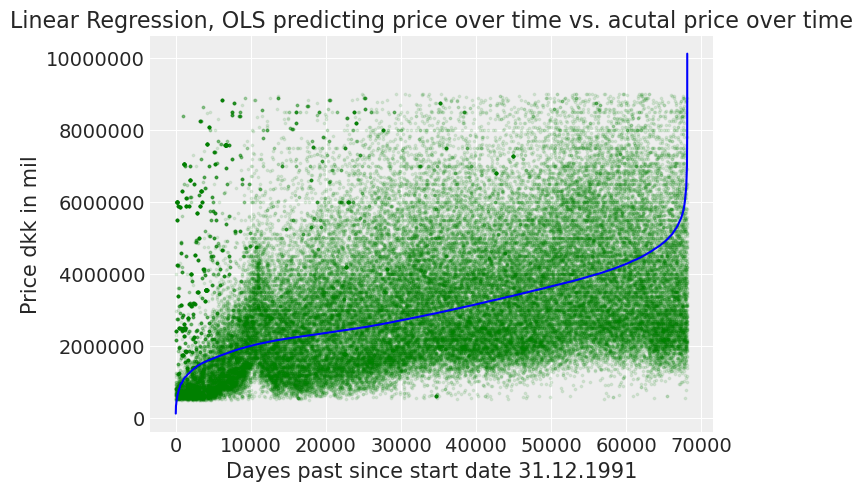

In [22]:
plt.plot(g.index, g.sort_values(by="y_pred")["y_pred"], c='b')
plt.scatter(g.index,g['price'],alpha=.1, s=3, c ='g')
plt.ylabel('Price dkk in mil')
plt.xlabel('Dayes past since start date 31.12.1991')
plt.title('Linear Regression, OLS predicting price over time vs. acutal price over time')
plt.ticklabel_format(axis='y', style='plain')
plt.show()

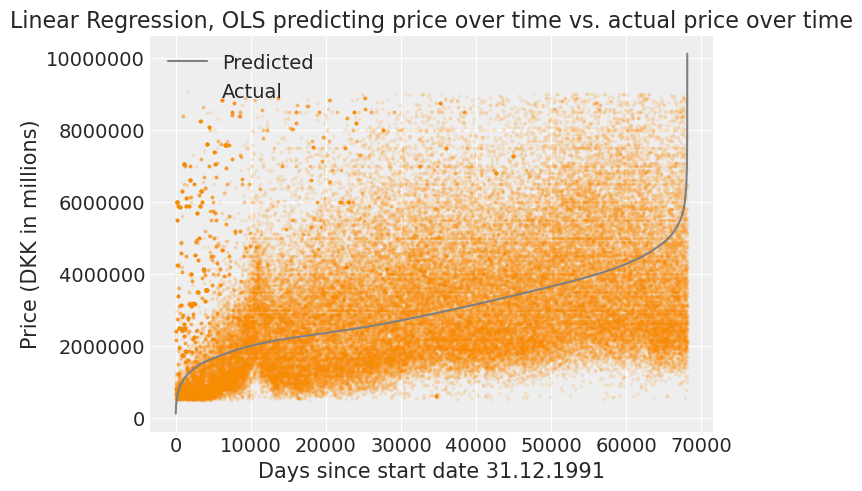

In [23]:
plt.plot(g.index, g.sort_values(by="y_pred")["y_pred"], c='gray', label='Predicted')
plt.scatter(g.index, g['price'], alpha=.1, s=3, c='darkorange', label='Actual')
plt.ylabel('Price (DKK in millions)')
plt.xlabel('Days since start date 31.12.1991')
plt.title('Linear Regression, OLS predicting price over time vs. actual price over time')
plt.ticklabel_format(axis='y', style='plain')

plt.legend()
#plt.savefig('OLS')

plt.show()

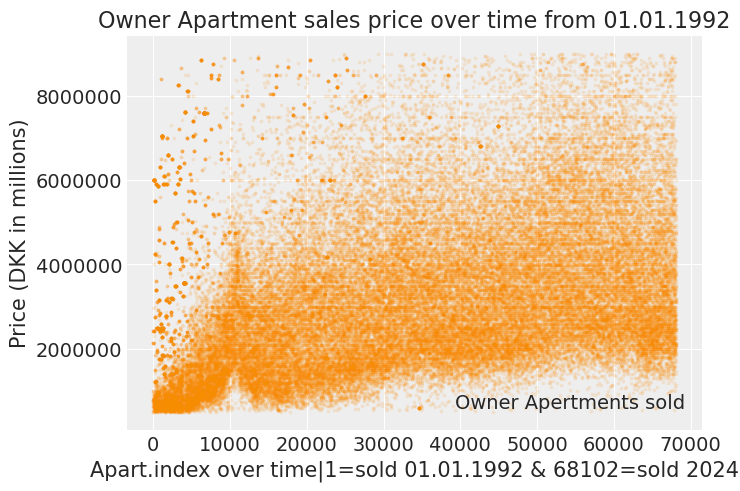

In [24]:
#plt.plot(g.index, g.sort_values(by="y_pred")["y_pred"], c='gray', label='Predicted')
plt.scatter(g.index, g['price'], alpha=.1, s=3, c='darkorange', label='Owner Apertments sold')
plt.ylabel('Price (DKK in millions)')
plt.xlabel('Apart.index over time|1=sold 01.01.1992 & 68102=sold 2024')
plt.title('Owner Apartment sales price over time from 01.01.1992')
plt.ticklabel_format(axis='y', style='plain')

plt.legend()
#plt.savefig('OLS')

plt.show()

In [27]:
import statsmodels.api as sm

In [33]:
 #Fit the linear regression model
X = sm.add_constant(X)  # Add a constant term for the intercept
model = sm.OLS(y, X).fit()

# Print the summary to see regression statistics
print(model.summary())

# Perform a t-test on the coefficient for "rooms" and check if it's equal to 2
hypothesis = "rooms = 2"  # Test if the coefficient of "rooms" is equal to 2
t_test_result = model.t_test(hypothesis)
print("T-test on the coefficient for 'rooms':")
print(t_test_result)

# You can also specify custom hypotheses
hypothesis = "rooms = 2"  # Test if the coefficient of X is equal to 2
print(model.t_test(hypothesis))

# Get the coefficients
coefficients = model.params
print("Coefficients:", coefficients)

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.412
Model:                            OLS   Adj. R-squared:                  0.412
Method:                 Least Squares   F-statistic:                 1.591e+04
Date:                Thu, 02 Nov 2023   Prob (F-statistic):               0.00
Time:                        11:14:35   Log-Likelihood:                -42001.
No. Observations:               68104   AIC:                         8.401e+04
Df Residuals:                   68100   BIC:                         8.405e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         10.2621      0.030    336.937      0.0

In [35]:
# Convert the summary to LaTeX table format
latex_table = model.summary().as_latex()

# Print the LaTeX table
#print(latex_table)